1.（李骜）（a）对于阻尼振动，振子在运动过程中受到阻力$f=\alpha v$，其中$\alpha$是一个描述阻力大小的参数。则阻尼振动的运动方程为

$$m\ddot{x}=-m\omega_0^2 x-\alpha \dot{x}$$

于是可以得到

$$\frac{d^2 x}{dt^2}+\frac{\alpha}{m}\frac{dx}{dt}+\omega_0^2 x=0$$

当参数$\alpha=\mu m (x^2-x_0^2)$时上式变为

$$\frac{d^2 x}{dt^2}+\mu(x^2-x_0^2)\frac{dx}{dt}+\omega_0^2 x=0 \tag{1}$$

其中阻尼参数$\alpha$显然与$x$有关，因此方程(1)描述了一个阻尼振动，其阻力与位移$x$有关。







（b）为计算方便，取$\mu=1,x_0=1,\omega_0=1$

再加入边界条件，使问题变成解方程

$$ \left \{
    \begin{aligned}
    &\frac{d^2 x}{dt^2}+(x^2-1)\frac{dx}{dt}+x=0 \\
    \\
    &x(0)=0\\
    &x'(0)=1\\
    \end{aligned}
    \right.$$

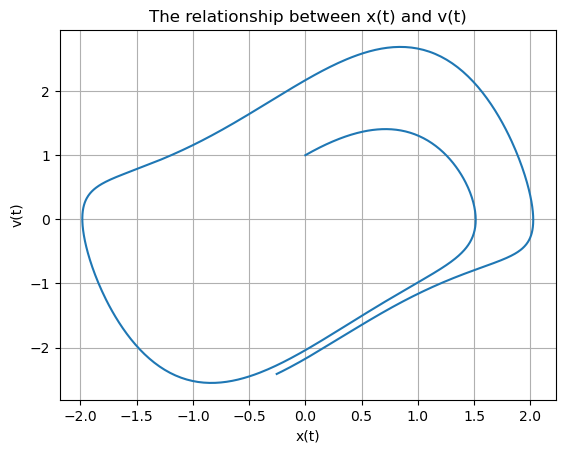

In [10]:
import numpy as np
import matplotlib.pyplot as plt

def f(t, x, v):
    return -x - (x**2 - 1) * v

def solve_equation(t0, x0, v0, dt, num_steps):
    t = np.zeros(num_steps)
    x = np.zeros(num_steps)
    v = np.zeros(num_steps)
    
    t[0] = t0
    x[0] = x0
    v[0] = v0
    
    for i in range(1, num_steps):
        x[i] = x[i-1] + v[i-1] * dt
        v[i] = v[i-1] + f(t[i-1], x[i-1], v[i-1]) * dt
        t[i] = t[i-1] + dt
    
    return t, x, v

t0 = 0.0
x0 = 0.0
v0 = 1.0

dt = 0.01
num_steps = 1000

t, x, v = solve_equation(t0, x0, v0, dt, num_steps)

plt.plot(x, v)
plt.xlabel('x(t)')
plt.ylabel('v(t)')
plt.title('The relationship between x(t) and v(t)')
plt.grid(True)
plt.show()





（c）将上面计算的步长从1000次提升至100000次，重新画图。

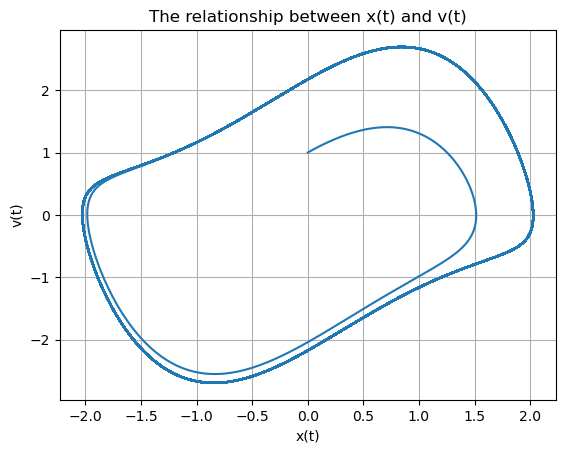

In [11]:
t0 = 0.0
x0 = 0.0
v0 = 1.0

dt = 0.01
num_steps = 100000

t, x, v = solve_equation(t0, x0, v0, dt, num_steps)

plt.plot(x, v)
plt.xlabel('x(t)')
plt.ylabel('v(t)')
plt.title('The relationship between x(t) and v(t)')
plt.grid(True)
plt.show()


可以发现出现了明显的边界，在轨道内部时会向外延伸至极限环。

更改初始条件为

$$ \left \{
    \begin{aligned}
    x(0)=3\\
    x'(0)=5\\
    \end{aligned}
    \right.$$

重新计算并与上一张图叠加，可以得到



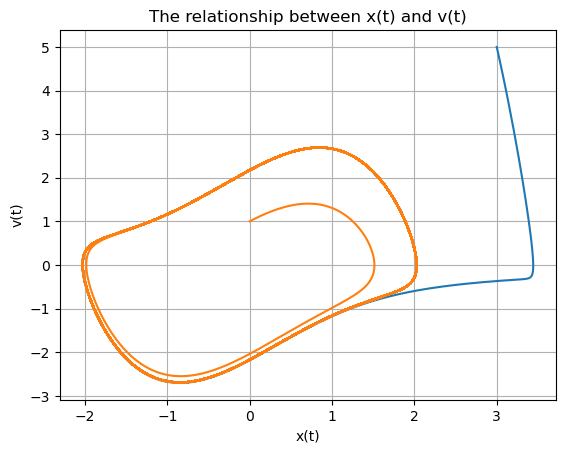

In [12]:
t0 = 0.0
x0 = 3.0
v0 = 5.0

dt = 0.01
num_steps = 100000

t, x, v = solve_equation(t0, x0, v0, dt, num_steps)

t0 = 0.0
x0 = 0.0
v0 = 1.0

dt = 0.01
num_steps = 100000

t1, x1, v1 = solve_equation(t0, x0, v0, dt, num_steps)

plt.plot(x, v)
plt.plot(x1, v1)
plt.xlabel('x(t)')
plt.ylabel('v(t)')
plt.title('The relationship between x(t) and v(t)')
plt.grid(True)
plt.show()

可以发现初始条件处于环外时会向内螺旋延伸。

2.（李泽锟）（a）要解方程

$$\frac{d^2 x}{dt^2}+2\gamma\frac{dx}{dt}+\alpha x+\beta x^3=Fcos(\omega t)$$

可以自定义参数和初始条件。

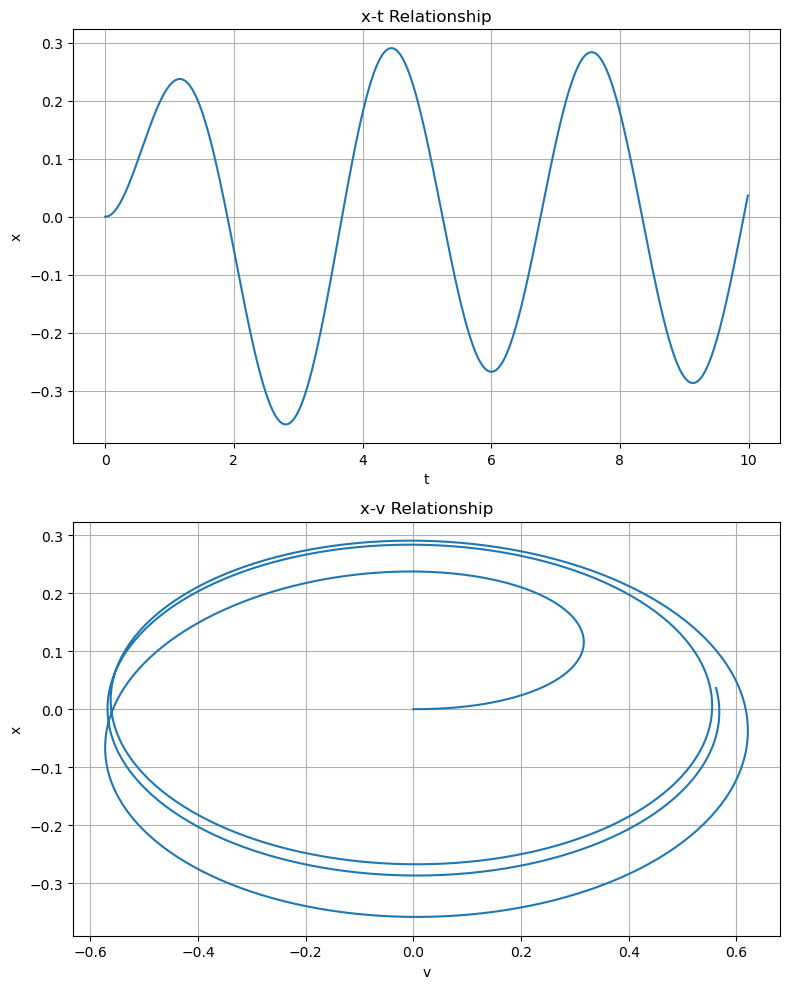

In [2]:
import numpy as np
import matplotlib.pyplot as plt

gamma = 0.5
alpha = 1.0
beta = 1.0
F = 1.0
omega = 2.0
dt = 0.01
num_steps = 1000

t = np.zeros(num_steps)
x = np.zeros(num_steps)
v = np.zeros(num_steps)

t[0] = 0.0
x[0] = 0.0
v[0] = 0.0

for i in range(1, num_steps):
    t[i] = t[i-1] + dt
    x[i] = x[i-1] + v[i-1] * dt
    v[i] = v[i-1] + (-2*gamma*v[i-1] - alpha*x[i-1] - beta*x[i-1]**3 + F*np.cos(omega*t[i-1])) * dt


fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 10))

ax1.plot(t, x)
ax1.set_xlabel('t')
ax1.set_ylabel('x')
ax1.set_title('x-t Relationship')
ax1.grid(True)

ax2.plot(v, x)
ax2.set_xlabel('v')
ax2.set_ylabel('x')
ax2.set_title('x-v Relationship')
ax2.grid(True)
plt.tight_layout()
plt.show()





（b）从图上可以明显看出$x(t)$与正弦曲线的相似以及相空间为椭圆形。

（c）对于给定的初始值，可以这样求解

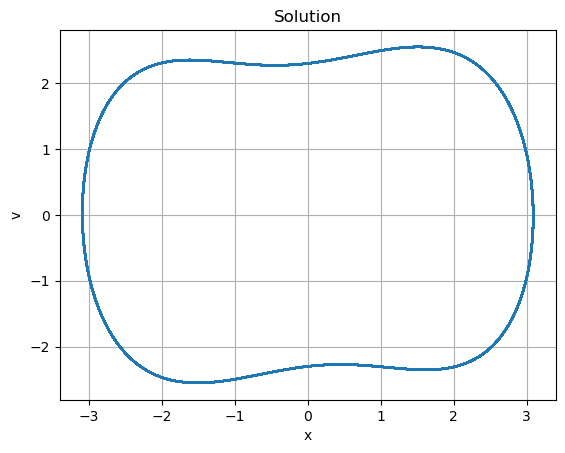

In [24]:
gamma = 0.2
alpha = 1.0
beta = 0.2
F = 4.0
omega = 1.0
dt = 0.01
num_steps = 100000

t = np.zeros(num_steps)
x = np.zeros(num_steps)
v = np.zeros(num_steps)

t[0] = 0.0
x[0] = 0.009
v[0] = 0.0

for i in range(1, num_steps):
    t[i] = t[i-1] + dt
    x[i] = x[i-1] + v[i-1] * dt
    v[i] = v[i-1] + (-2*gamma*v[i-1] - alpha*x[i-1] - beta*x[i-1]**3 + F*np.cos(omega*t[i-1])) * dt

start_index = int(20000 * np.pi)
plt.plot(x[start_index:], v[start_index:])
plt.xlabel('x')
plt.ylabel('v')
plt.title('Solution')
plt.grid(True)
plt.show()

（d）$\alpha=0,\beta=1,\gamma=0.04,\omega=1,F=0.2$

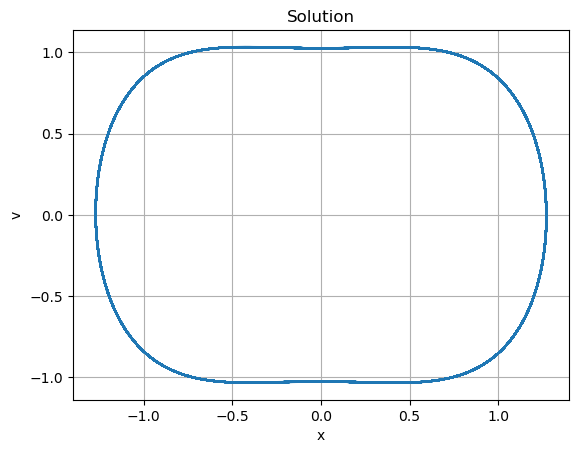

In [8]:
gamma = 0.04
alpha = 0.0
beta = 1.0
F = 0.2
omega = 1.0
dt = 0.01
num_steps = 100000

t = np.zeros(num_steps)
x = np.zeros(num_steps)
v = np.zeros(num_steps)

t[0] = 0.0
x[0] = 1.1
v[0] = 0.1

for i in range(1, num_steps):
    t[i] = t[i-1] + dt
    x[i] = x[i-1] + v[i-1] * dt
    v[i] = v[i-1] + (-2*gamma*v[i-1] - alpha*x[i-1] - beta*x[i-1]**3 + F*np.cos(omega*t[i-1])) * dt

start_index = int(num_steps * 0.2)
plt.plot(x[start_index:], v[start_index:])
plt.xlabel('x')
plt.ylabel('v')
plt.title('Solution')
plt.grid(True)
plt.show()

3.（李骜）对于方程组
    $$ \left \{
    \begin{aligned}
    \frac{dx}{dt}&=\sigma(y-x)\\
    \frac{dy}{dt}&=\rho x-y-xz\\
    \frac{dz}{dt}&=-\beta z+xy\\
    \end{aligned}
    \right.$$
在计算过程中取初值$x(0)=1.y(0)=1,z(0)=1$

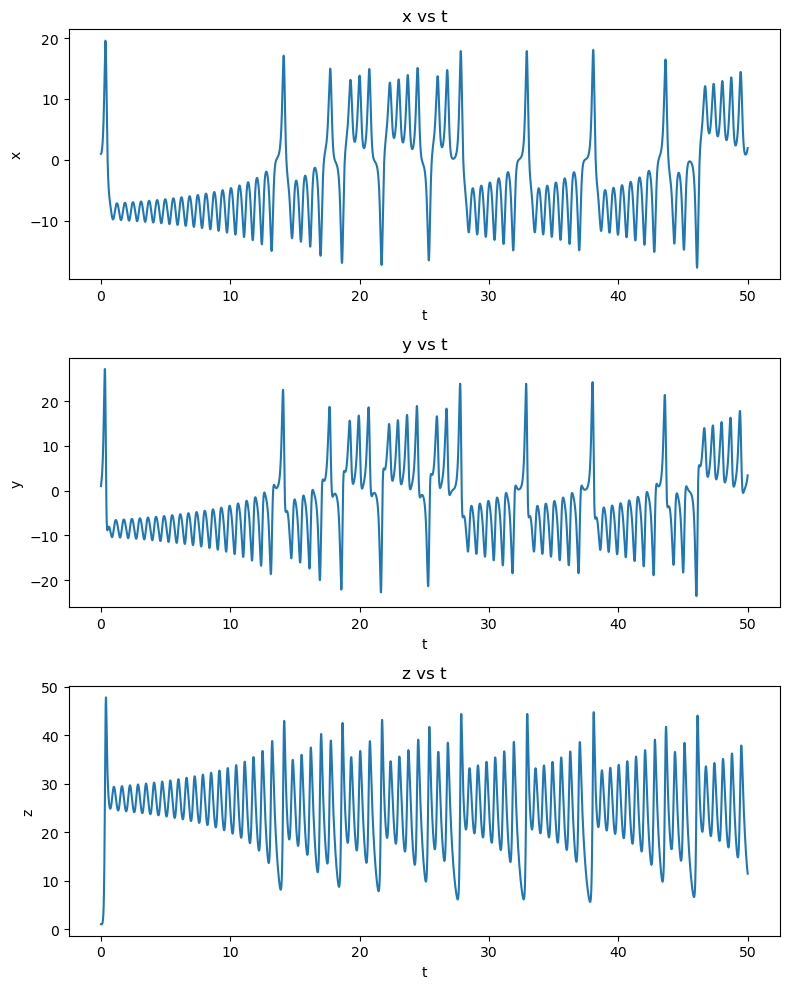

In [16]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt

sigma = 10.0
rho = 28.0
beta = 8/3

def lorenz_system(t, xyz):
    x, y, z = xyz
    dxdt = sigma * (y - x)
    dydt = rho * x - y - x * z
    dzdt = -beta * z + x * y
    return [dxdt, dydt, dzdt]

initial_conditions = [1.0, 1.0, 1.0]

t_start = 0.0
t_end = 50.0
num_points = 10000

def rk45_solver(lorenz_system, initial_conditions, t_start, t_end, num_points):
    t = np.linspace(t_start, t_end, num_points)
    dt = t[1] - t[0]
    n = len(initial_conditions)
    solution = np.zeros((num_points, n))
    solution[0] = initial_conditions

    for i in range(1, num_points):
        k1 = lorenz_system(t[i-1], solution[i-1])
        k2 = lorenz_system(t[i-1] + dt/2, solution[i-1] + dt/2 * np.array(k1))
        k3 = lorenz_system(t[i-1] + dt/2, solution[i-1] + dt/2 * np.array(k2))
        k4 = lorenz_system(t[i-1] + dt, solution[i-1] + dt * np.array(k3))

        solution[i] = solution[i-1] + dt/6 * (np.array(k1) + 2*np.array(k2) + 2*np.array(k3) + np.array(k4))

    return t, solution



t, solution = rk45_solver(lorenz_system, initial_conditions, t_start, t_end, num_points)


x = solution[:, 0]
y = solution[:, 1]
z = solution[:, 2]

fig, axs = plt.subplots(3, 1, figsize=(8, 10))

axs[0].plot(t, x)
axs[0].set_title('x vs t')
axs[0].set_xlabel('t')
axs[0].set_ylabel('x')

axs[1].plot(t, y)
axs[1].set_title('y vs t')
axs[1].set_xlabel('t')
axs[1].set_ylabel('y')

axs[2].plot(t, z)
axs[2].set_title('z vs t')
axs[2].set_xlabel('t')
axs[2].set_ylabel('z')

plt.tight_layout()
plt.show()





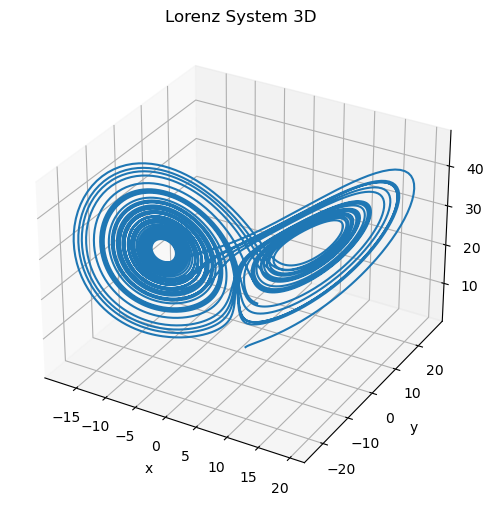

In [17]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot(x, y, z)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
ax.set_title('Lorenz System 3D')
plt.show()


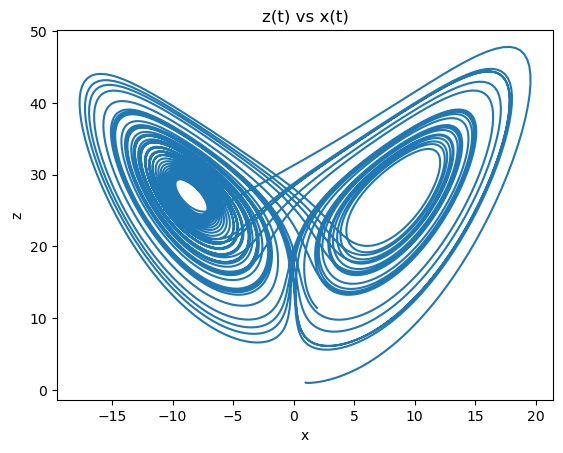

In [18]:
plt.plot(x,z)
plt.xlabel('x')
plt.ylabel('z')
plt.title('z(t) vs x(t)')
plt.show()


4.（李泽锟）
$$\frac{\partial T(x,t)}{\partial t}=\frac{K}{C\rho}\frac{\partial^2T}{\partial x^2}-bT(x,t)$$

取$K=237,C=900,\rho=2700,b=3,T(x,0)=373,T(x,T)=0$进行求解。

In [19]:
import numpy as np
import plotly.graph_objects as go

K = 237
C = 900
rho = 2700
L = 1  
N = 100  
dx = L / N  
T0 = 373  
t_max = 1.0  
dt = 0.001  
nt = int(t_max / dt)  

def Sol4(b):
    T = np.zeros((nt+1, N+1))
    T[0, :] = T0  

    alpha = K / (C * rho)
    gamma = alpha * dt / dx**2

    for j in range(nt):
        for i in range(1, N):
            T[j+1, i] = T[j, i] + gamma * (T[j, i+1] - 2*T[j, i] + T[j, i-1]) - b * T[j, i] * dt

    x = np.arange(N+1)*dx
    t = np.arange(nt+1)*dt
    return x,t,T

b = 3 

x, t, T = Sol4(b)
x, t = np.meshgrid(x, t)

fig = go.Figure(data=[go.Surface(x=x, y=t, z=T)])
fig.update_layout(title=f'b={b}', scene=dict(xaxis_title='x', yaxis_title='t', zaxis_title='T'))
fig.show()


In [20]:
b=1
x, t, T = Sol4(b)
x, t = np.meshgrid(x, t)

fig = go.Figure(data=[go.Surface(x=x, y=t, z=T)])
fig.update_layout(title=f'b={b}', scene=dict(xaxis_title='x', yaxis_title='t', zaxis_title='T'))
fig.show()

b=10
x, t, T = Sol4(b)
x, t = np.meshgrid(x, t)

fig = go.Figure(data=[go.Surface(x=x, y=t, z=T)])
fig.update_layout(title=f'b={b}', scene=dict(xaxis_title='x', yaxis_title='t', zaxis_title='T'))
fig.show()


(c)在方程中，b的作用是描述温度对热辐射的负反馈效应，b的值越大，温度下降的速度就越快。